In [1]:
import pandas as pd
import geopandas as gpd
import folium
import numpy as np

import urllib.request, json 
import contextily as ctx
import matplotlib.pyplot as plt
import plotly.express as px
import urllib.request, json 
import plotly.express as px
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import matplotlib.pyplot as plt
import plotly.express as px
from sodapy import Socrata
import seaborn as sns
from pointpats import centrography
from matplotlib.patches import Ellipse
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import contextily as ctx
from sodapy import Socrata
import seaborn as sns
from pointpats import centrography
from matplotlib.patches import Ellipse

import urllib.request, json 
import plotly.express as px
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import matplotlib.pyplot as plt
import plotly.express as px

/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
df = pd.read_csv(
    'Data/20072011.csv',
    dtype=
    {
        'FIPS':str,
        'State (FIPS)':str,
        'County': str 
    }
)

In [3]:
#df = df.dropna() 

In [4]:
df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2347 entries, 0 to 2346
Columns: 133 entries, FIPS to Hispanic or Latino Population for Whom Poverty  Status Is Determined: Income in 2011 At or Above Poverty Level
dtypes: object(133)
memory usage: 2.4+ MB


In [5]:
df.shape

(2347, 133)

In [6]:
columns = list(df) # this is the same as df.columns.to_list()
columns

['FIPS',
 'Name of Area',
 'Qualifying Name',
 'State/U.S.-Abbreviation (USPS)',
 'Summary Level',
 'Geographic Component',
 'File Identification',
 'Logical Record Number',
 'US',
 'Region',
 'Division',
 'State (Census Code)',
 'State (FIPS)',
 'County',
 'County Subdivision (FIPS)',
 'Place (FIPS Code)',
 'Place (State FIPS + Place FIPS)',
 'Census Tract',
 'Block Group',
 'Consolidated City',
 'American Indian Area/Alaska Native Area/Hawaiian Home Land (Census)',
 'American Indian Area/Alaska Native Area/Hawaiian Home Land (FIPS)',
 'American Indian Trust Land/Hawaiian Home Land Indicator',
 'American Indian Tribal Subdivision (Census)',
 'American Indian Tribal Subdivision (FIPS)',
 'Alaska Native Regional Corporation (FIPS)',
 'Metropolitan and Micropolitan Statistical Area',
 'Combined Statistical Area',
 'Metropolitan Division',
 'Metropolitan Area Central City',
 'Metropolitan/Micropolitan Indicator Flag',
 'New England City and Town Combined Statistical Area',
 'New England C

In [7]:
columns_to_keep = ['FIPS',
                     'Name of Area',
                     'Qualifying Name',
                     'State (FIPS)',
                     'County',
                     'Total Population',
                     'Population 16 Years and Over:',
                     'Population 16 Years and Over: in Labor Force: Civilian: Employed',
                     'Population 16 Years and Over: in Labor Force: Civilian: Unemployed',
                     'White Alone Population for Whom Poverty Status Is  Determined:',
                     'White Alone Population for Whom Poverty Status Is  Determined: Income in 2011 Below Poverty Level',
                     'White Alone Population for Whom Poverty Status Is  Determined: Income in 2011 At or Above Poverty Level',
                     'Black or African American Alone Population for  Whom Poverty Status Is Determined:',
                     'Black or African American Alone Population for &nbsp;&nbsp;&nbsp; Whom&nbsp;&nbsp; Poverty Status Is Determined: Income in 2011 Below Poverty Level',
                     'Black or African American Alone Population for &nbsp;&nbsp;&nbsp; Whom&nbsp;&nbsp; Poverty Status Is Determined: Income in 2011 At or Above Poverty Level',
                     'American Indian and Alaska Native Alone  Population for Whom Poverty Status Is Determined:',
                     'American Indian and Alaska Native Alone &nbsp; Population&nbsp;&nbsp; For&nbsp;&nbsp; Whom Poverty Status Is Determined: Income in 2011 Below Poverty Level',
                     'American Indian and Alaska Native Alone &nbsp; Population&nbsp;&nbsp; For&nbsp;&nbsp; Whom Poverty Status Is Determined: Income in 2011 At or Above Poverty Level',
                     'Asian Alone Population for Whom Poverty Status Is  Determined:',
                     'Asian Alone Population for Whom Poverty Status Is  Determined: Income in 2011 Below Poverty Level',
                     'Asian Alone Population for Whom Poverty Status Is  Determined: Income in 2011 At or Above Poverty Level',
                     'Native Hawaiian and Other Pacific Islander Alone  Population for Whom Poverty Status Is Determined:',
                     'Native Hawaiian and Other Pacific Islander&nbsp; Alone&nbsp;&nbsp; &nbsp;&nbsp; Population for Whom Poverty<br />&nbsp;&nbsp; Status Is Determined: Income in 2011 Below Poverty Level',
                     'Native Hawaiian and Other Pacific Islander&nbsp; Alone&nbsp;&nbsp; &nbsp;&nbsp; Population for Whom Poverty<br />&nbsp;&nbsp; Status Is Determined: Income in 2011 At or Above Poverty Level',
                     'Some Other Race Alone Population for Whom Poverty  Status Is Determined:',
                     'Some Other Race Alone Population for Whom Poverty  Status Is Determined: Income in 2011 Below Poverty Level',
                     'Some Other Race Alone Population for Whom Poverty  Status Is Determined: Income in 2011 At or Above Poverty Level',
                     'Two or More Races Population for Whom Poverty  Status Is Determined:',
                     'Two or More Races Population for Whom Poverty  Status Is Determined: Income in 2011 Below Poverty Level',
                     'Two or More Races Population for Whom Poverty  Status Is Determined: Income in 2011 At or Above Poverty Level',
                     'Hispanic or Latino Population for Whom Poverty  Status Is Determined:',
                     'Hispanic or Latino Population for Whom Poverty  Status Is Determined: Income in 2011 Below Poverty Level',
                     'Hispanic or Latino Population for Whom Poverty  Status Is Determined: Income in 2011 At or Above Poverty Level']
 

 

In [8]:
df = df[columns_to_keep]

In [9]:
df.columns = ['FIPS',
             'Name of Area',
             'Qualifying Name',
             'State (FIPS)',
             'County',
             'Total Population',
             'Population 16 Years and Over',
             'Population Employed',
             'Population Unemployed',
             'Total White Population Poverty',
             'White Population Income in 2011 Below Poverty Level',
             'White Population Income in 2011 At or Above Poverty Level',
             'Total Black Population Poverty',
             'Black Population Income in 2011 Below Poverty Level',
             'Black Population Income in 2011 At or Above Poverty Level',
             'Total AIAN Population Poverty',
             'AIAN Population Income in 2011 Below Poverty Level',
             'AIAN Population Income in 2011 At or Above Poverty Level',
             'Total Asian Population Poverty',
             'Asian Population Income in 2011 Below Poverty Level',
             'Asian Population Income in 2011 At or Above Poverty Level',
             'Total NHPIA Population Poverty',
             'NHPIA Population Income in 2011 Below Poverty Level',
             'NHPIA Population Income in 2011 At or Above Poverty Level',
             'Total Some Other Race Population Poverty',
             'Some Other Race Population Income in 2011 Below Poverty Level',
             'Some Other Race Population Income in 2011 At or Above Poverty Level',
             'Total Two or More Races Population for Whom Poverty',
             'Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level',
             'Two or More Races Population Poverty  Status Income in 2011 At or Above Poverty Level',
             'Total Latino Population Poverty',
             'Latino Population Income in 2011 Below Poverty Level',
             'Latino Population Income in 2011 At or Above Poverty Level']



In [12]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [13]:
df['Total Population'] = pd.to_numeric(df['Total Population'], errors='coerce').fillna(0)
df['Total Population'] = df['Total Population'].astype(np.int64)

In [14]:
df['Population 16 Years and Over'] = pd.to_numeric(df['Population 16 Years and Over'], errors='coerce').fillna(0)
df['Population Employed'] = pd.to_numeric(df['Population Employed'], errors='coerce').fillna(0)
df['Population Unemployed'] = pd.to_numeric(df['Population Unemployed'], errors='coerce').fillna(0)
df['Total White Population Poverty'] = pd.to_numeric(df['Total White Population Poverty'], errors='coerce').fillna(0)
df['White Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['White Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['White Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['White Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total Black Population Poverty'] = pd.to_numeric(df['Total Black Population Poverty'], errors='coerce').fillna(0)
df['Black Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['Black Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['Black Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['Black Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total AIAN Population Poverty'] = pd.to_numeric(df['Total AIAN Population Poverty'], errors='coerce').fillna(0)
df['AIAN Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['AIAN Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['AIAN Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['AIAN Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total Asian Population Poverty'] = pd.to_numeric(df['Total Asian Population Poverty'], errors='coerce').fillna(0)
df['Asian Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['Asian Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Asian Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['Asian Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['Total NHPIA Population Poverty'] = pd.to_numeric(df['Total NHPIA Population Poverty'], errors='coerce').fillna(0)
df['NHPIA Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['NHPIA Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['NHPIA Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['NHPIA Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total Some Other Race Population Poverty'] = pd.to_numeric(df['Total Some Other Race Population Poverty'], errors='coerce').fillna(0)
df['Some Other Race Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['Some Other Race Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['Some Other Race Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['Some Other Race Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total Two or More Races Population for Whom Poverty'] = pd.to_numeric(df['Total Two or More Races Population for Whom Poverty'], errors='coerce').fillna(0)
df['Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level'] = pd.to_numeric(df['Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['Two or More Races Population Poverty  Status Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['Two or More Races Population Poverty  Status Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)
df['Total Latino Population Poverty'] = pd.to_numeric(df['Total Latino Population Poverty'], errors='coerce').fillna(0)
df['Latino Population Income in 2011 Below Poverty Level'] = pd.to_numeric(df['Latino Population Income in 2011 Below Poverty Level'], errors='coerce').fillna(0)
df['Latino Population Income in 2011 At or Above Poverty Level'] = pd.to_numeric(df['Latino Population Income in 2011 At or Above Poverty Level'], errors='coerce').fillna(0)

In [15]:
df['Population 16 Years and Over'] = df['Population 16 Years and Over'].astype(np.int64)
df['Population Employed'] = df['Population Employed'].astype(np.int64)
df['Population Unemployed'] = df['Population Unemployed'].astype(np.int64)

In [16]:
df['Total White Population Poverty'] = df['Total White Population Poverty'].astype(np.int64)
df['White Population Income in 2011 Below Poverty Level'] = df['White Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['White Population Income in 2011 At or Above Poverty Level'] = df['White Population Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total Black Population Poverty'] = df['Total Black Population Poverty'].astype(np.int64)
df['Black Population Income in 2011 Below Poverty Level'] = df['Black Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['Black Population Income in 2011 At or Above Poverty Level'] = df['Black Population Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total AIAN Population Poverty'] = df['Total AIAN Population Poverty'].astype(np.int64)
df['AIAN Population Income in 2011 Below Poverty Level'] = df['AIAN Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['AIAN Population Income in 2011 At or Above Poverty Level'] = df['AIAN Population Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total Asian Population Poverty'] = df['Total Asian Population Poverty'].astype(np.int64)
df['Asian Population Income in 2011 Below Poverty Level'] = df['Asian Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['Asian Population Income in 2011 At or Above Poverty Level'] = df['Asian Population Income in 2011 At or Above Poverty Level'].astype(np.int64)


In [17]:
df['Total NHPIA Population Poverty'] = df['Total NHPIA Population Poverty'].astype(np.int64)
df['NHPIA Population Income in 2011 Below Poverty Level'] = df['NHPIA Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['NHPIA Population Income in 2011 At or Above Poverty Level'] = df['NHPIA Population Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total Some Other Race Population Poverty'] = df['Total Some Other Race Population Poverty'].astype(np.int64)
df['Some Other Race Population Income in 2011 Below Poverty Level'] = df['Some Other Race Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['Some Other Race Population Income in 2011 At or Above Poverty Level'] = df['Some Other Race Population Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total Two or More Races Population for Whom Poverty'] = df['Total Two or More Races Population for Whom Poverty'].astype(np.int64)
df['Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level'] = df['Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level'].astype(np.int64)
df['Two or More Races Population Poverty  Status Income in 2011 At or Above Poverty Level'] = df['Two or More Races Population Poverty  Status Income in 2011 At or Above Poverty Level'].astype(np.int64)
df['Total Latino Population Poverty'] = df['Total Latino Population Poverty'].astype(np.int64)
df['Latino Population Income in 2011 Below Poverty Level'] = df['Latino Population Income in 2011 Below Poverty Level'].astype(np.int64)
df['Latino Population Income in 2011 At or Above Poverty Level'] = df['Latino Population Income in 2011 At or Above Poverty Level'].astype(np.int64)

In [18]:
df['Percent Population Employed'] = df['Population Employed']/df['Population 16 Years and Over']*100
df['Percent Population Unemployed'] = df['Population Unemployed']/df['Population 16 Years and Over']*100

In [19]:
df['Percent Population Employed'] = pd.to_numeric(df['Percent Population Employed'], errors='coerce').fillna(0)
df['Percent Population Employed'] = df['Percent Population Employed'].astype(np.int64)

In [20]:
df['Percent Population Unemployed'] = pd.to_numeric(df['Percent Population Unemployed'], errors='coerce').fillna(0)
df['Percent Populatio Unemployed'] = df['Percent Population Unemployed'].astype(np.int64)

In [23]:
df['Percent of White Population Income in 2011 Below Poverty Level'] = df['White Population Income in 2011 Below Poverty Level']/df['Total White Population Poverty']*100
df['Percent Black Population Income in 2011 Below Poverty Level'] = df['Black Population Income in 2011 Below Poverty Level']/df['Total Black Population Poverty']*100
df['Percent AIAN Population Income in 2011 Below Poverty Level'] = df['AIAN Population Income in 2011 Below Poverty Level']/df['Total AIAN Population Poverty']*100
df['Percent Asian Population Income in 2011 Below Poverty Level'] = df['Asian Population Income in 2011 Below Poverty Level']/df['Total Asian Population Poverty']*100
df['Percent NHPIA Population Income in 2011 Below Poverty Level'] = df['NHPIA Population Income in 2011 Below Poverty Level']/df['Total NHPIA Population Poverty']*100
df['Percent Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level'] = df['Two or More Races Population Poverty  Status Income in 2011 Below Poverty Level']/df['Total Two or More Races Population for Whom Poverty']*100
df['Percent Latino Population Income in 2011 Below Poverty Level'] = df['Latino Population Income in 2011 Below Poverty Level']/df['Total Latino Population Poverty']*100


In [15]:
df.head (5)

,FIPS,Name of Area,Qualifying Name,State (FIPS),County,Total Population,Population 16 Years and Over,Population Employed,Population Unemployed,Total White Population Poverty,...,Some Other Race Population Income in 2010 At or Above Poverty Level,Total Two or More Races Population for Whom Poverty,Two or More Races Population Poverty Status Income in 2010 Below Poverty Level,Two or More Races Population Poverty Status Income in 2010 At or Above Poverty Level,Total Latino Population Poverty,Latino Population Income in 2010 Below Poverty Level,Latino Population Income in 2010 At or Above Poverty Level,Percent Population Employed,Percent Population Unemployed,Percent Populatio Unemployed
0,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.000000,0
1,06037101110,"Census Tract 1011.10, Los Angeles County, Cali...","Census Tract 1011.10, Los Angeles County, Cali...",06,037,5017,3954,2512,175,3879,...,374,102,0,102,1085,292,793,63,4.425898,4
2,06037101122,"Census Tract 1011.22, Los Angeles County, Cali...","Census Tract 1011.22, Los Angeles County, Cali...",06,037,3663,3042,1932,102,2617,...,22,167,0,167,451,165,286,63,3.353057,3
3,06037101210,"Census Tract 1012.10, Los Angeles County, Cali...","Census Tract 1012.10, Los Angeles County, Cali...",06,037,6799,5370,3317,307,4470,...,902,71,0,71,2790,1122,1668,61,5.716946,5
4,06037101220,"Census Tract 1012.20, Los Angeles County, Cali...","Census Tract 1012.20, Los Angeles County, Cali...",06,037,3189,2631,1620,153,2364,...,538,40,40,0,1148,155,993,61,5.815279,5


In [24]:
df = df.drop([0])

In [17]:
df.dtypes

FIPS                                                                                      object
Name of Area                                                                              object
Qualifying Name                                                                           object
State (FIPS)                                                                              object
County                                                                                    object
Total Population                                                                           int64
Population 16 Years and Over                                                               int64
Population Employed                                                                        int64
Population Unemployed                                                                      int64
Total White Population Poverty                                                             int64
White Population Income in 201

In [25]:
tracts=gpd.read_file('Data/tracts.geojson')

In [26]:
tracts = tracts[['name','geometry']]
tracts.head()

,name,geometry
0,06037101110,"MULTIPOLYGON (((-118.30229 34.25870, -118.3007..."
1,06037101122,"MULTIPOLYGON (((-118.30333 34.27354, -118.3031..."
2,06037101210,"MULTIPOLYGON (((-118.29945 34.25598, -118.2859..."
3,06037101220,"MULTIPOLYGON (((-118.28592 34.24896, -118.2859..."
4,06037101300,"MULTIPOLYGON (((-118.27247 34.23253, -118.2719..."


In [27]:
tracts.columns = ['FIPS','geometry']

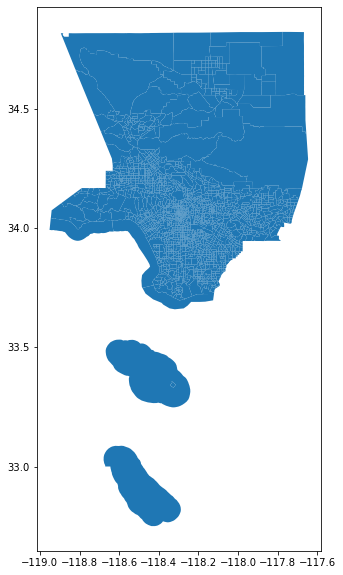

In [21]:
tracts.plot(figsize=(12,10))

In [28]:
tracts_race=tracts.merge(df,on="FIPS")

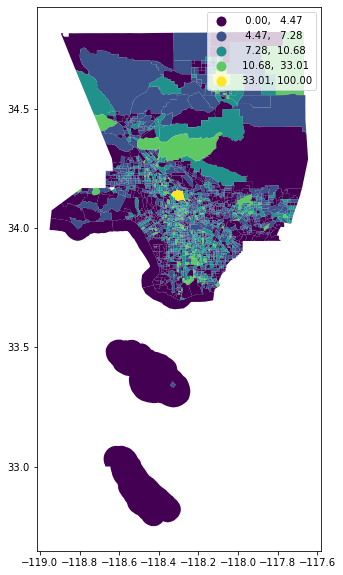

In [29]:
tracts_race.plot(figsize=(12,10),
                 column='Percent Population Unemployed',
                 legend=True, 
                 scheme='NaturalBreaks')

In [26]:
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
folium.Choropleth(
                  geo_data=tracts_race, # geo data
                  data=tracts_race, # data          
                  key_on='feature.properties.FIPS', # key, or merge column
                  columns=['FIPS', 'Population Unemployed'], # [key, value]
                  fill_color='BuPu',
                  line_weight=0.4, 
                  fill_opacity=0.8,
                  line_opacity=0.2, # line opacity (of the border)
                  legend_name='Population Black in 2012').add_to(m)    # name on the legend color bar
m

In [63]:
# Council Districts
gdf_cd = gpd.read_file('http://boundaries.latimes.com/1.0/boundary-set/la-city-council-districts-2012/?format=geojson')

In [64]:
# function to create a council district map
def cd_map(name = '9', column = 'Population Unemployed_per_1000_lag'):
    # this cd
    this_cd = gdf_cd[gdf_cd['name']==name]
    
    # spatial join to get tracts
    tracts = gpd.sjoin(tracts_race,this_cd)

    # plot it
    fig,ax = plt.subplots()

    # map
    tracts.plot(ax=ax,
                column=column, 
                vmin=20,
                vmax=100,
                legend=True)

    ax.axis('off')
    ax.set_title('Council District ' + name + '\n(' + column + ')', fontsize=14)

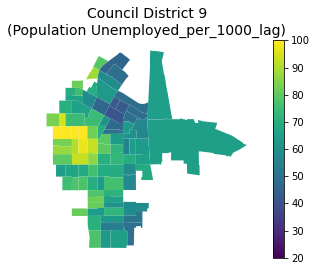

In [65]:
cd_map ()

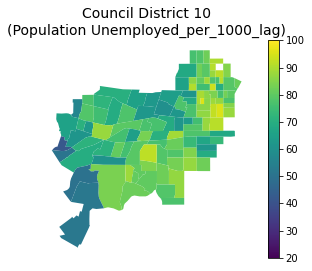

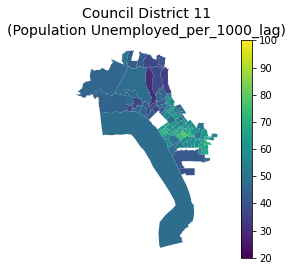

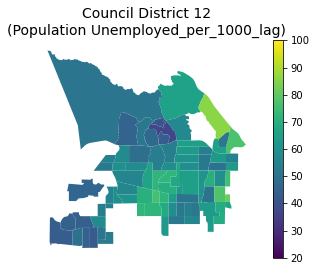

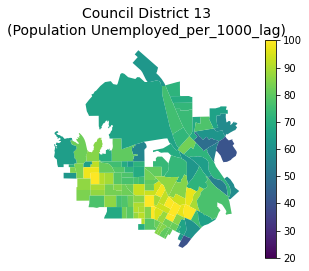

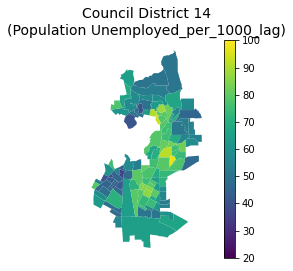

...

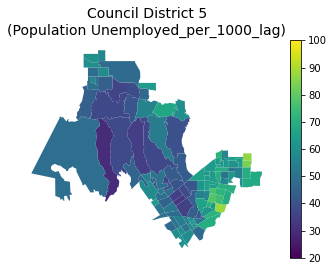

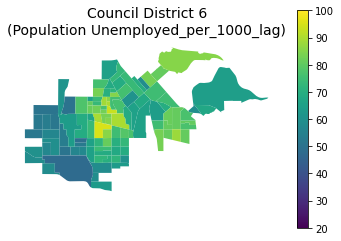

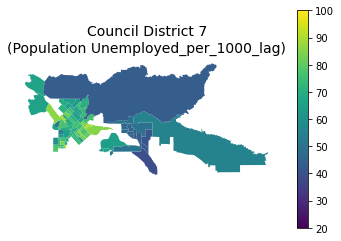

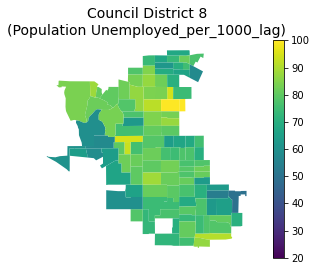

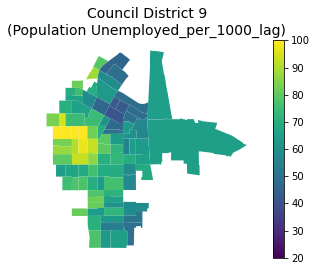

In [72]:
for index, row in gdf_cd.iterrows():
    cd_map(name = row['name'])

In [39]:
minx, miny, maxx, maxy = tracts_race.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-118.951721
-117.646374
32.75004
34.823301


In [37]:
tracts_race_web = tracts_race.to_crs('EPSG:4326')

In [38]:
tracts_race.sort_values(by='Percent Population Unemployed', ascending = True).tail(50)

,FIPS,geometry,Name of Area,Qualifying Name,State (FIPS),County,Total Population,Population 16 Years and Over,Population Employed,Population Unemployed,Total White Population Poverty,White Population Income in 2011 Below Poverty Level,White Population Income in 2011 At or Above Poverty Level,Total Black Population Poverty,Black Population Income in 2011 Below Poverty Level,Black Population Income in 2011 At or Above Poverty Level,Total AIAN Population Poverty,AIAN Population Income in 2011 Below Poverty Level,AIAN Population Income in 2011 At or Above Poverty Level,Total Asian Population Poverty,Asian Population Income in 2011 Below Poverty Level,Asian Population Income in 2011 At or Above Poverty Level,Total NHPIA Population Poverty,NHPIA Population Income in 2011 Below Poverty Level,NHPIA Population Income in 2011 At or Above Poverty Level,Total Some Other Race Population Poverty,Some Other Race Population Income in 2011 Below Poverty Level,Some Other Race Population Income in 2011 At or Above Poverty Level,Total Two or More Races Population for Whom Poverty,Two or More Races Population Poverty Status Income in 2011 Below Poverty Level,Two or More Races Population Poverty Status Income in 2011 At or Above Poverty Level,Total Latino Population Poverty,Latino Population Income in 2011 Below Poverty Level,Latino Population Income in 2011 At or Above Poverty Level,Percent Population Employed,Percent Population Unemployed,Percent Populatio Unemployed,Percent of White Population Income in 2011 Below Poverty Level,Percent Black Population Income in 2011 Below Poverty Level,Percent AIAN Population Income in 2011 Below Poverty Level,Percent Asian Population Income in 2011 Below Poverty Level,Percent NHPIA Population Income in 2011 Below Poverty Level,Percent Two or More Races Population Poverty Status Income in 2011 Below Poverty Level,Percent Latino Population Income in 2011 Below Poverty Level
481,06037197600,"MULTIPOLYGON (((-118.25623 34.06785, -118.2522...","Census Tract 1976, Los Angeles County, California","Census Tract 1976, Los Angeles County, California",06,037,2276,1876,1107,244,1139,242,897,38,0,38,0,0,0,712,93,619,43,0,43,261,106,155,83,0,83,1066,334,732,59,13.006397,13,21.246708,0.000000,NaN,13.061798,0.000000,0.000000,31.332083
369,06037183620,"MULTIPOLYGON (((-118.19448 34.11592, -118.1937...","Census Tract 1836.20, Los Angeles County, Cali...","Census Tract 1836.20, Los Angeles County, Cali...",06,037,3337,2554,1342,335,2320,592,1728,50,10,40,5,0,5,457,56,401,0,0,0,403,68,335,10,0,10,2374,636,1738,52,13.116680,13,25.517241,20.000000,0.000000,12.253829,NaN,0.000000,26.790227
761,06037236203,"MULTIPOLYGON (((-118.35240 34.02151, -118.3451...","Census Tract 2362.03, Los Angeles County, Cali...","Census Tract 2362.03, Los Angeles County, Cali...",06,037,3861,2765,1344,363,285,271,14,2983,621,2362,32,0,32,69,0,69,0,0,0,456,23,433,36,0,36,757,294,463,48,13.128391,13,95.087719,20.817968,0.000000,0.000000,NaN,0.000000,38.837517
734,06037231800,"MULTIPOLYGON (((-118.28097 34.00408, -118.2809...","Census Tract 2318, Los Angeles County, California","Census Tract 2318, Los Angeles County, California",06,037,5146,3588,1963,472,991,413,578,602,211,391,18,0,18,0,0,0,0,0,0,3348,1603,1745,187,54,133,4462,1953,2509,54,13.154961,13,41.675076,35.049834,0.000000,NaN,NaN,28.877005,43.769610
874,06037269601,"MULTIPOLYGON (((-118.38253 34.04138, -118.3819...","Census Tract 2696.01, Los Angeles County, Cali...","Census Tract 2696.01, Los Angeles County, Cali...",06,037,3704,2830,1779,375,1606,161,1445,482,22,460,21,21,0,86,0,86,0,0,0,1280,203,1077,186,0,186,2599,310,2289,62,13.250883,13,10.024907,4.564315,100.000000,0.000000,NaN,0.000000,11.927664
2284,06037920106,"MULTIPOLYGON (((-118.72657 34.47451, -118.7259...","Census Tract 9201.06, Los Angeles County, Cali...","Census Tract 9201.06, Los Angeles County, Cali...",06,037,3007,2222,1361,295,2223,276,1947,87,0,87,0,0,0,59,37,22,0,0,0,430,46,384,208,31,177,1637,249,1388,61,13.276328,13,12.41

In [40]:
tracts_race['Population Unemployed_per_1000']= tracts_race['Population Unemployed']/tracts_race['Population 16 Years and Over']*1000
tracts_race['Population Employed_per_1000'] = tracts_race['Population Employed']/tracts_race['Population 16 Years and Over']*1000


In [41]:
wq =  lps.weights.KNN.from_dataframe(tracts_race,k=8)

wq.transform = 'r'

In [42]:
tracts_race['Population Unemployed_per_1000_lag'] = lps.weights.lag_spatial(wq, tracts_race['Population Unemployed_per_1000'])
tracts_race['Population Employed_per_1000_lag'] = lps.weights.lag_spatial(wq, tracts_race['Population Employed_per_1000'])




In [43]:
tracts_race['Population Unemployed_per_1000_lag_diff'] = tracts_race['Population Unemployed_per_1000'] - tracts_race['Population Unemployed_per_1000_lag']
tracts_race['Population Employed_per_1000_lag_diff'] = tracts_race['Population Employed_per_1000'] - tracts_race['Population Employed_per_1000_lag']



In [44]:
tracts_race.sort_values(by="Population Unemployed_per_1000_lag").head(100)

,FIPS,geometry,Name of Area,Qualifying Name,State (FIPS),County,Total Population,Population 16 Years and Over,Population Employed,Population Unemployed,Total White Population Poverty,White Population Income in 2011 Below Poverty Level,White Population Income in 2011 At or Above Poverty Level,Total Black Population Poverty,Black Population Income in 2011 Below Poverty Level,Black Population Income in 2011 At or Above Poverty Level,Total AIAN Population Poverty,AIAN Population Income in 2011 Below Poverty Level,AIAN Population Income in 2011 At or Above Poverty Level,Total Asian Population Poverty,Asian Population Income in 2011 Below Poverty Level,Asian Population Income in 2011 At or Above Poverty Level,Total NHPIA Population Poverty,NHPIA Population Income in 2011 Below Poverty Level,NHPIA Population Income in 2011 At or Above Poverty Level,Total Some Other Race Population Poverty,Some Other Race Population Income in 2011 Below Poverty Level,Some Other Race Population Income in 2011 At or Above Poverty Level,Total Two or More Races Population for Whom Poverty,Two or More Races Population Poverty Status Income in 2011 Below Poverty Level,Two or More Races Population Poverty Status Income in 2011 At or Above Poverty Level,Total Latino Population Poverty,Latino Population Income in 2011 Below Poverty Level,Latino Population Income in 2011 At or Above Poverty Level,Percent Population Employed,Percent Population Unemployed,Percent Populatio Unemployed,Percent of White Population Income in 2011 Below Poverty Level,Percent Black Population Income in 2011 Below Poverty Level,Percent AIAN Population Income in 2011 Below Poverty Level,Percent Asian Population Income in 2011 Below Poverty Level,Percent NHPIA Population Income in 2011 Below Poverty Level,Percent Two or More Races Population Poverty Status Income in 2011 Below Poverty Level,Percent Latino Population Income in 2011 Below Poverty Level,Population Unemployed_per_1000,Population Employed_per_1000,Population Unemployed_per_1000_lag,Population Employed_per_1000_lag,Population Unemployed_per_1000_lag_diff,Population Employed_per_1000_lag_diff
2095,06037670407,"MULTIPOLYGON (((-118.39078 33.76557, -118.3908...","Census Tract 6704.07, Los Angeles County, Cali...","Census Tract 6704.07, Los Angeles County, Cali...",06,037,6133,4608,2417,249,2243,55,2188,235,0,235,0,0,0,3221,545,2676,70,0,70,136,0,136,228,40,188,399,0,399,52,5.403646,5,2.452073,0.000000,NaN,16.920211,0.0,17.543860,0.000000,54.036458,524.522569,21.411046,513.798185,32.625412,10.724385
2090,06037670326,"MULTIPOLYGON (((-118.42276 33.78568, -118.4215...","Census Tract 6703.26, Los Angeles County, Cali...","Census Tract 6703.26, Los Angeles County, Cali...",06,037,3837,3104,1423,44,2678,23,2655,43,12,31,0,0,0,1060,0,1060,0,0,0,11,0,11,36,0,36,209,2,207,45,1.417526,1,0.858850,27.906977,NaN,0.000000,NaN,0.000000,0.956938,14.175258,458.440722,23.511180,554.826818,-9.335922,-96.386096
2091,06037670328,"MULTIPOLYGON (((-118.43306 33.77281, -118.4332...","Census Tract 6703.28, Los Angeles County, Cali...","Census Tract 6703.28, Los Angeles County, Cali...",06,037,4489,3582,1728,91,3242,60,3182,80,0,80,0,0,0,868,67,801,0,0,0,0,0,0,292,0,292,139,0,139,48,2.540480,2,1.850709,0.000000,NaN,7.718894,NaN,0.000000,0.000000,25.404802,482.412060,23.894670,520.532900,1.510132,-38.120839
2079,06037651302,"MULTIPOLYGON (((-118.39050 33.80469, -118.3902...","Census Tract 6513.02, Los Angeles County, Cali...","Census Tract 6513.02, Los Angeles County, Cali...",06,037,5847,4815,2846,217,4155,171,3984,3,1,2,38,38,0,911,88,823,0,0,0,110,0,110,530,24,506,682,38,644,59,4.506750,4,4.115523,33.333333,100.000000,9.659715,NaN,4.528302,5.571848,45.067497,591.069574,25.604419,631.197135,19.463078,-40.127561
2097,06037670413,"MULTIPOLYGON (((-118.40363 33.76632, -118.4037...","Census Tract 6704.13, Los Angeles County, Cali...","Census Tract 6704.13, Los Angeles County, Cali...",06,037,4960,3828,2072,118,2659,112,2547,135,97,38,31,0,31,1848,55,1793,0,0,

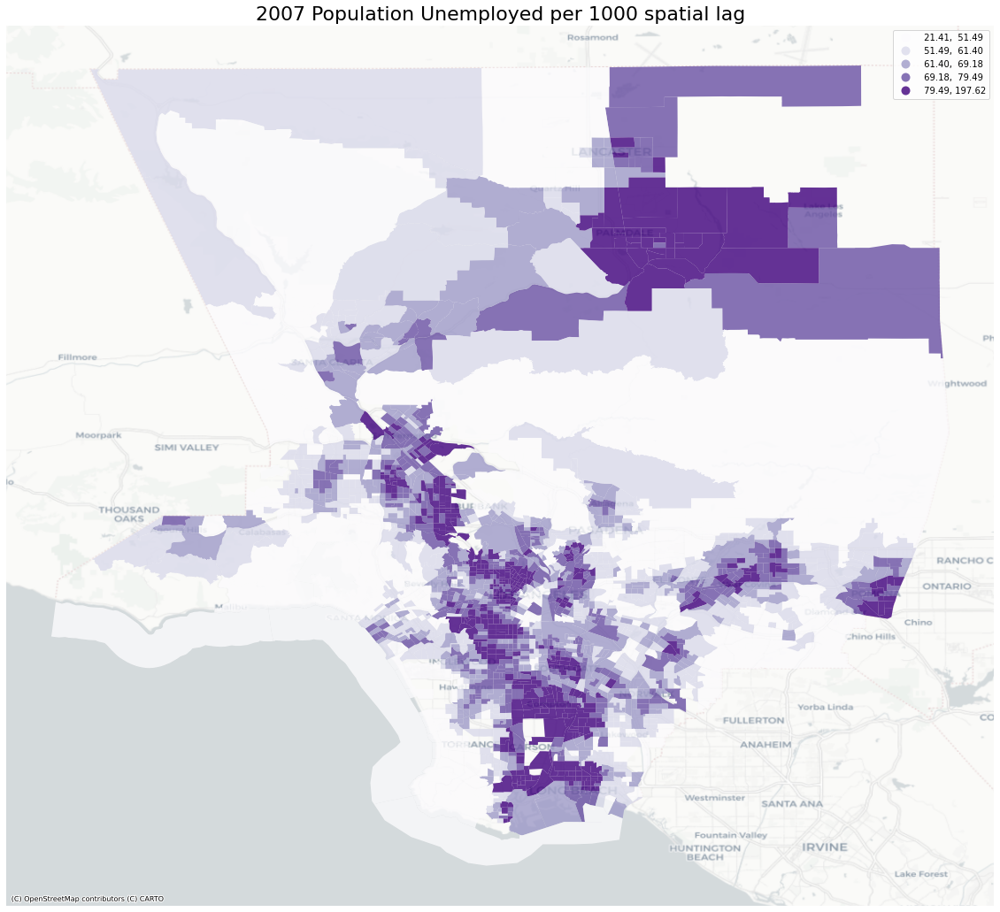

In [62]:
fig,ax = plt.subplots(figsize=(20,20))

tracts_race.plot(ax=ax,
        column='Population Unemployed_per_1000_lag',
        legend=True,
        alpha=0.8,
        cmap='Purples',
        scheme='quantiles')

ax.axis('off')
ax.set_title('2007 Population Unemployed per 1000 spatial lag',fontsize=22)
ctx.add_basemap(ax,
                crs='epsg:4326', # surprise! You can change the crs here!
                source=ctx.providers.CartoDB.Positron)

In [47]:
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
folium.Choropleth(
                  geo_data=tracts_race, # geo data
                  data=tracts_race, # data          
                  key_on='feature.properties.FIPS', # key, or merge column
                  columns=['FIPS', 'Population Unemployed_per_1000_lag'], # [key, value]
                  fill_color='BuPu',
                  line_weight=0.4, 
                  fill_opacity=0.6,
                  line_opacity=0.2, # line opacity (of the border)
                  legend_name='2007 Population Unemployed per 1000 spatial lag').add_to(m)    # name on the legend color bar
m

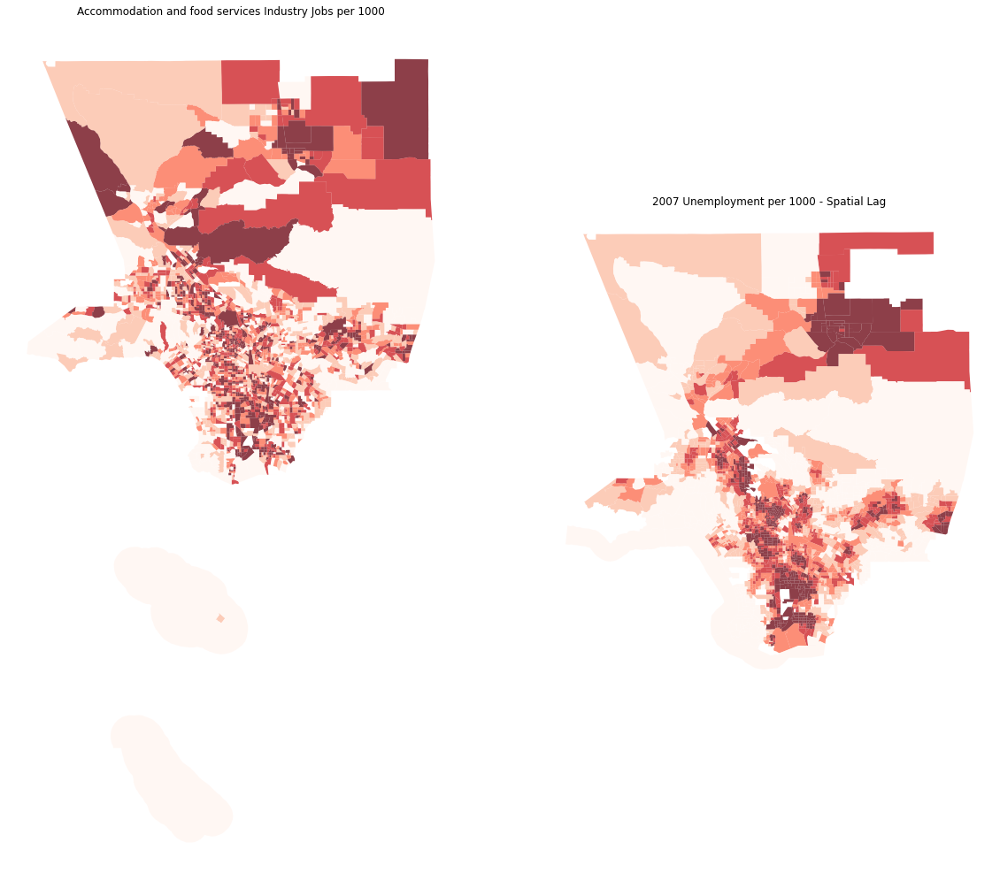

In [61]:
fig, ax = plt.subplots(1, 2, figsize=(20, 20))
tracts_race.plot(ax=ax[0], 
         column='Population Unemployed_per_1000', 
         cmap='Reds', 
         scheme='quantiles',
         k=5, 
         edgecolor='grey', 
         linewidth=0, 
         alpha=0.75, 
           )


ax[0].axis("off")
ax[0].set_title("Accommodation and food services Industry Jobs per 1000")


tracts_race.plot(ax=ax[1], 
         column='Population Unemployed_per_1000_lag', 
         cmap='Reds', 
         scheme='quantiles',
         k=5, 
         edgecolor='grey', 
         linewidth=0, 
         alpha=0.75
           )

ax[1].axis("off")
ax[1].set_title("2007 Unemployment per 1000 - Spatial Lag")

plt.show()

In [59]:
tracts_race_web = tracts_race.to_crs('EPSG:4326')

In [30]:
def get_histogram(column = 'Percent Black Population Income in 2010 Below Poverty Level'):
    series_to_plot=df[column]

    plt.figure(figsize=(10,5))

    plt.hist(series_to_plot,bins=50,color='purple')

    plt.axvline(series_to_plot.mean(), color='k', linestyle='dashed', linewidth=1)
    plt.axvline(series_to_plot.median(), color='r', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(series_to_plot.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(series_to_plot.mean()))
    plt.text(series_to_plot.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(series_to_plot.median()),color='r')
    plt.title(column + ' in Los Angeles County 2006')

In [33]:
indicators = ['Percent of White Population Income in 2010 Below Poverty Level',
              'Percent Black Population Income in 2010 Below Poverty Level',
              'Percent AIAN Population Income in 2010 Below Poverty Level',
              'Percent Asian Population Income in 2010 Below Poverty Level',
              'Percent NHPIA Population Income in 2010 Below Poverty Level',
              'Percent Two or More Races Population Poverty  Status Income in 2010 Below Poverty Level',
              'Percent Latino Population Income in 2010 Below Poverty Level']

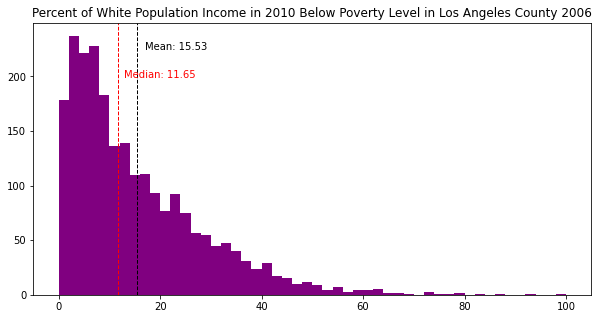

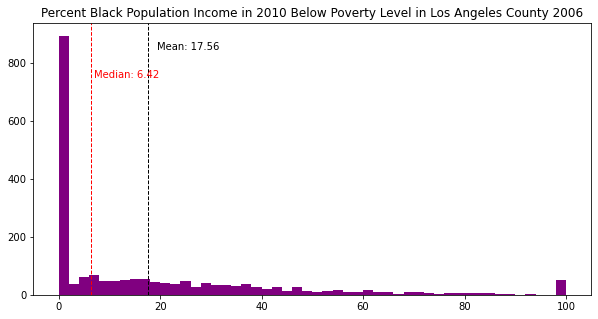

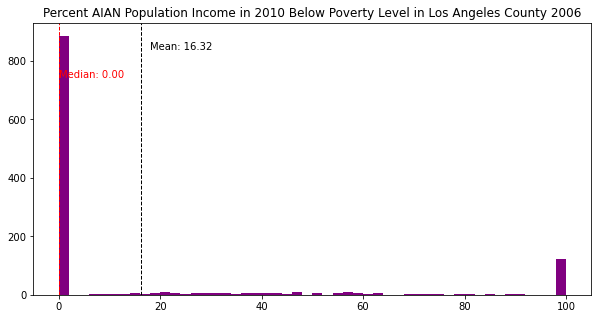

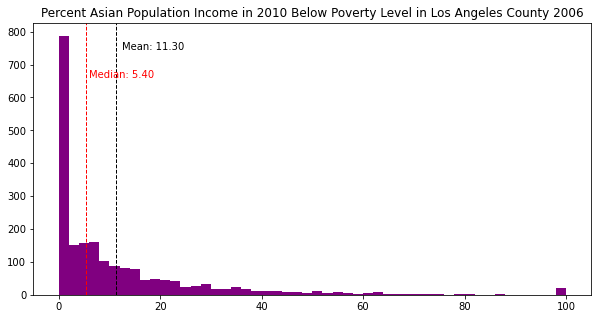

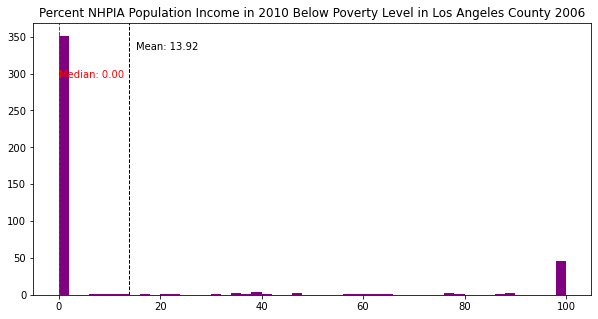

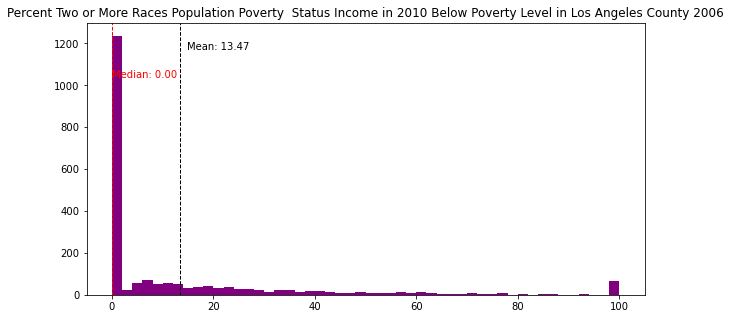

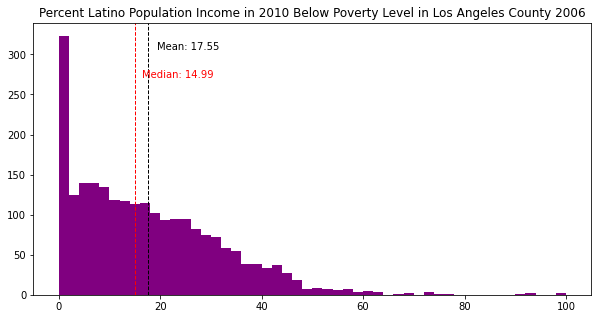

In [34]:
for indicator in indicators:
    get_histogram(column=indicator)